In [2]:
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx

%matplotlib inline

# Load Data
Load the network structure data saved in the previous Jupyer Notebook ([01-prepare_and_see_data.ipynb](https://github.com/komo-fr/SciPyJapan_2019_talk/blob/master/notebooks/01-prepare_and_see_data.ipynb)).

In [3]:
pep_graph = nx.read_gpickle('../data/output/pep_graph.gpickle')

# Basic Drawing

NetworkX has simple features for drawing.   
Please refer to the following URL for details.

** Drawing**   
https://networkx.github.io/documentation/networkx-1.10/reference/drawing.html

In [4]:
import pygraphviz
pygraphviz.__version__

'1.5'

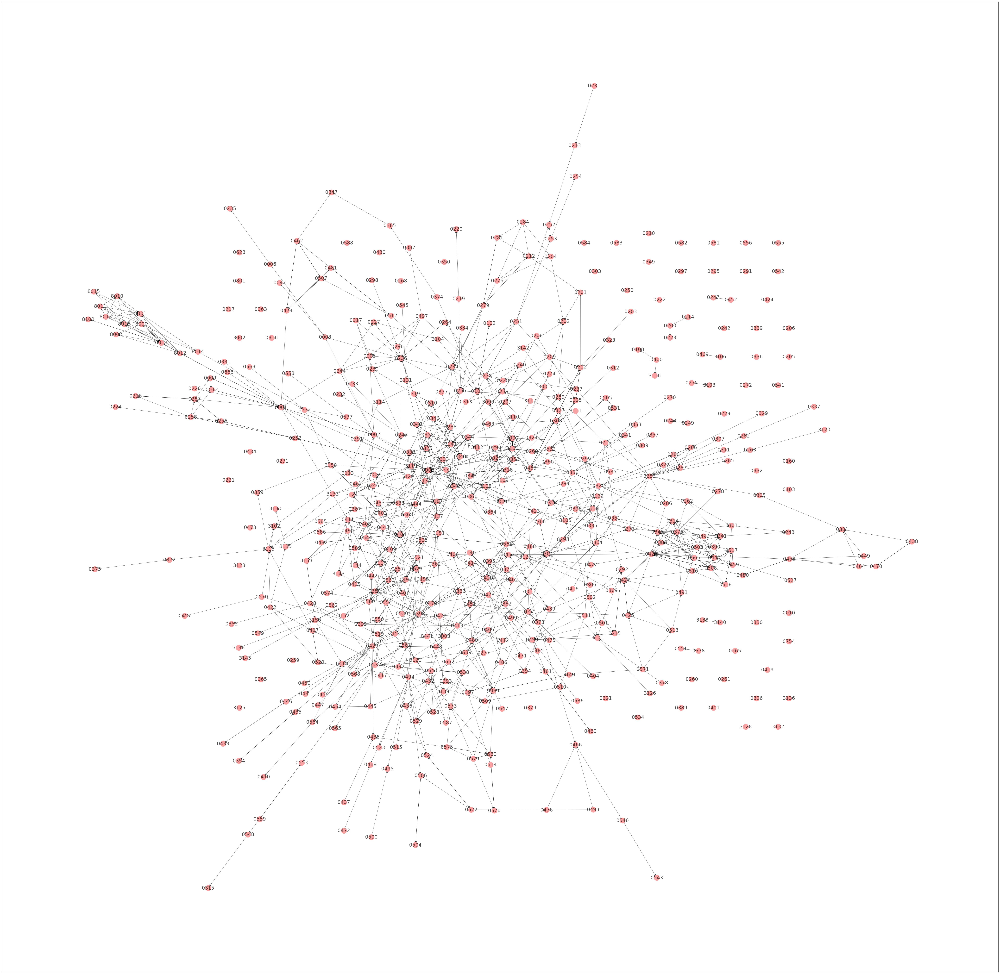

In [5]:
figure_size = (110, 110)
plt.figure(figsize=figure_size)

# Calc Layout
position_dict = nx.nx_agraph.graphviz_layout(pep_graph, prog='fdp')

# Draw
nx.draw_networkx_nodes(pep_graph, pos=position_dict, node_color="#ffa1a1", node_size=1200)
nx.draw_networkx_labels(pep_graph, pos=position_dict, font_size=30, alpha=0.7)
nx.draw_networkx_edges(pep_graph, pos=position_dict, alpha=0.7, arrowsize=30)

# Save and Show
Path('../images/drawing').mkdir(exist_ok=True, parents=True)
plt.savefig('../images/drawing/simple_network.png')
plt.show()

** Note**:   
If you specify fdp and call the `nx.nx_agraph.graphviz_layout` function, the spring model is used to calculate the layout. This result can change with each calculation.   
`nx.nx_agraph.graphviz_layout` uses **Graphviz** internally. For more information, see the Graphviz documentation.

**Graphviz**   
https://graphviz.gitlab.io/documentation/

The structure of the network is difficult to understand simply by drawing.   
The following sections show you how to make the network structure easier to understand.
- Re-layout the Isolated Nodes
- Change Color by Status
- Change Node Size by Degree
- Interactive Visualization

# Re-layout the Isolated Points

## Isolated Node
<img src="../images/isolated_node.png">

Let's take a closer look at the network diagram we just drew.     
There are some isolated nodes.   
To better understand the structure of the network, re-layout them side by side.   
The list of isolated nodes can be obtained using `nx.isokates` function.

<img src="../images/re-layout.png">

In [6]:
# Get the maximum (x, y) value of the current node
# to determine the position of the isolated node after re-layout.
max_x = max([x for x, y in position_dict.values()])
max_y = max([y for x, y in position_dict.values()])
max_x, max_y

(3084.7, 3399.9)

In [7]:
# Update position of isolated node
col_n = 20
isolated_node_position_dict = {node_id: (i % col_n * 100., max_y + 100 + 100 * (i//col_n))
                               for i, node_id in enumerate(nx.isolates(pep_graph))}
new_position_dict = position_dict.copy()
new_position_dict.update(isolated_node_position_dict)

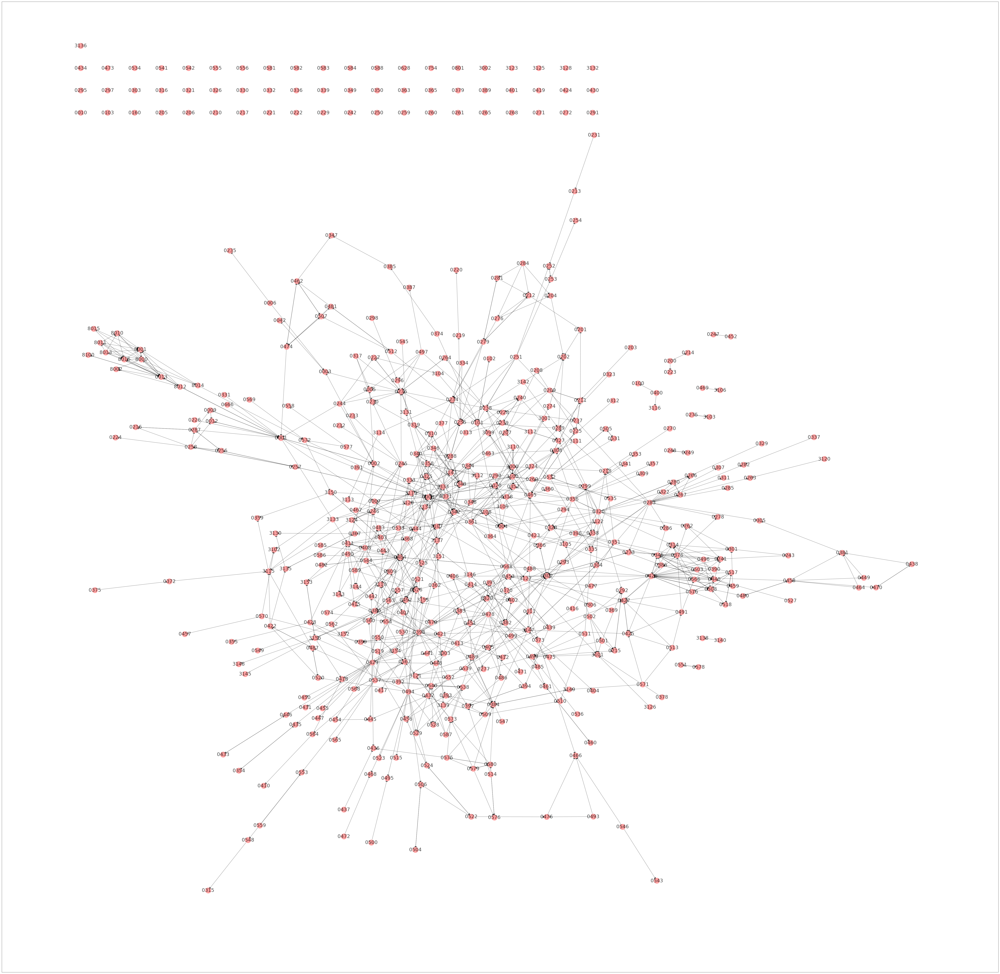

In [8]:
figure_size = (110, 110)
plt.figure(figsize=figure_size)

# Draw
nx.draw_networkx_nodes(pep_graph, pos=new_position_dict, node_color="#ffa1a1", node_size=1200)
nx.draw_networkx_labels(pep_graph, pos=new_position_dict, font_size=30, alpha=0.7)
nx.draw_networkx_edges(pep_graph, pos=new_position_dict, alpha=0.7, arrowsize=30)

plt.savefig('../images/drawing/network_new_position.png')
plt.show()

## Other Layout
`nx.nx _agraph.graphviz _layout` allows you to use the layout algorithm provided by `graphviz`.   
We used `fdp` this time, but you can use other layout algorithms.   
For example, you can specify `dot` as the layout to draw nodes hierarchically.

**networkx.drawing.nx_agraph.graphviz_layout**   
https://networkx.github.io/documentation/stable/reference/generated/networkx.drawing.nx_agraph.graphviz_layout.html#networkx.drawing.nx_agraph.graphviz_layout

**Graphviz**   
https://graphviz.gitlab.io/documentation/

NetworkX itself also provides some simple layout functions.   

**Layout**   
https://networkx.github.io/documentation/stable/reference/drawing.html#layout

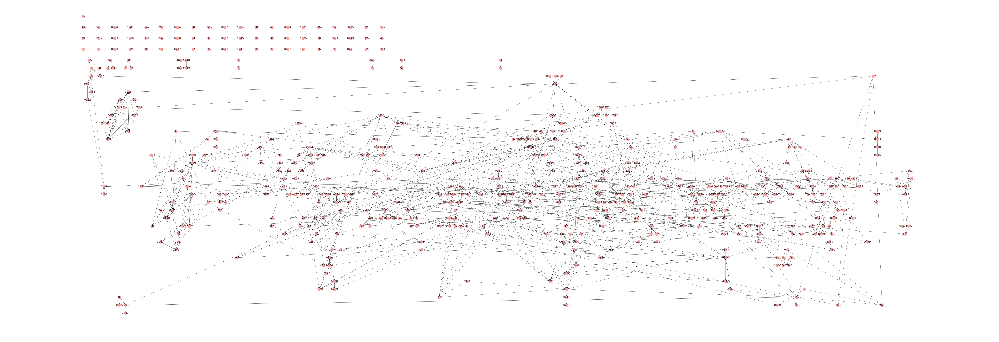

In [9]:
figure_size = (200, 70)
plt.figure(figsize=figure_size)

# Calc Layout
dot_position_dict = nx.nx_agraph.graphviz_layout(pep_graph, prog='dot')
max_x = max([x for x, y in dot_position_dict.values()])
max_y = max([y for x, y in dot_position_dict.values()])

col_n = 20
isolated_node_position_dict = {node_id: (i % col_n * 200., max_y + 100 + 100 * (i//col_n))
                               for i, node_id in enumerate(nx.isolates(pep_graph))}
dot_position_dict.update(isolated_node_position_dict )

# Draw
nx.draw_networkx_nodes(pep_graph, pos=dot_position_dict, node_color="#ffa1a1", node_size=1200)
nx.draw_networkx_labels(pep_graph, pos=dot_position_dict, font_size=30, alpha=0.7)
nx.draw_networkx_edges(pep_graph, pos=dot_position_dict, alpha=0.7, arrowsize=30)

plt.savefig('../images/drawing/simple_network_dot_position.png')
plt.show()

# Change Color by Status
<img src="../images/status_color.png">

In [01-prepare_and_see_data.ipynb](https://github.com/komo-fr/SciPyJapan_2019_talk/blob/master/notebooks/01-prepare_and_see_data.ipynb), we added the PEP header information as attributes of the node.   
Let's change the node color using the "Status" value.   
In particular, it is important whether the PEP is "awaking PEP" (Draft, Final, Active, etc.) or "sleeping PEP" (Rejected, Withdrawn, Superseeded, etc.).   
Assign lighter colors to the former, and darker colors to the latter.

In [10]:
STATUS_COLOR_MAP_DICT = {
    'Accepted': '#40AAEF',  # blue
    'Active': '#F27398',  # red
    'April Fool!': '#FFF200',  # blight yellow
    'Draft': '#FBA848',  # orange
    'Final': '#58BE89',  # green
    'Provisional': '#EDE496',  # yellow
    'Rejected': '#8A0808',  # dark red
    'Superseded': '#000000',  # black
    'Withdrawn': '#737373',  # dalk brown
    'Deferred': '#5F4C0B'  # gray
}

node_color_list = [STATUS_COLOR_MAP_DICT[status[1]] for status in list(pep_graph.nodes(data='Status'))]
node_color_list[:5]

['#F27398', '#58BE89', '#737373', '#F27398', '#F27398']

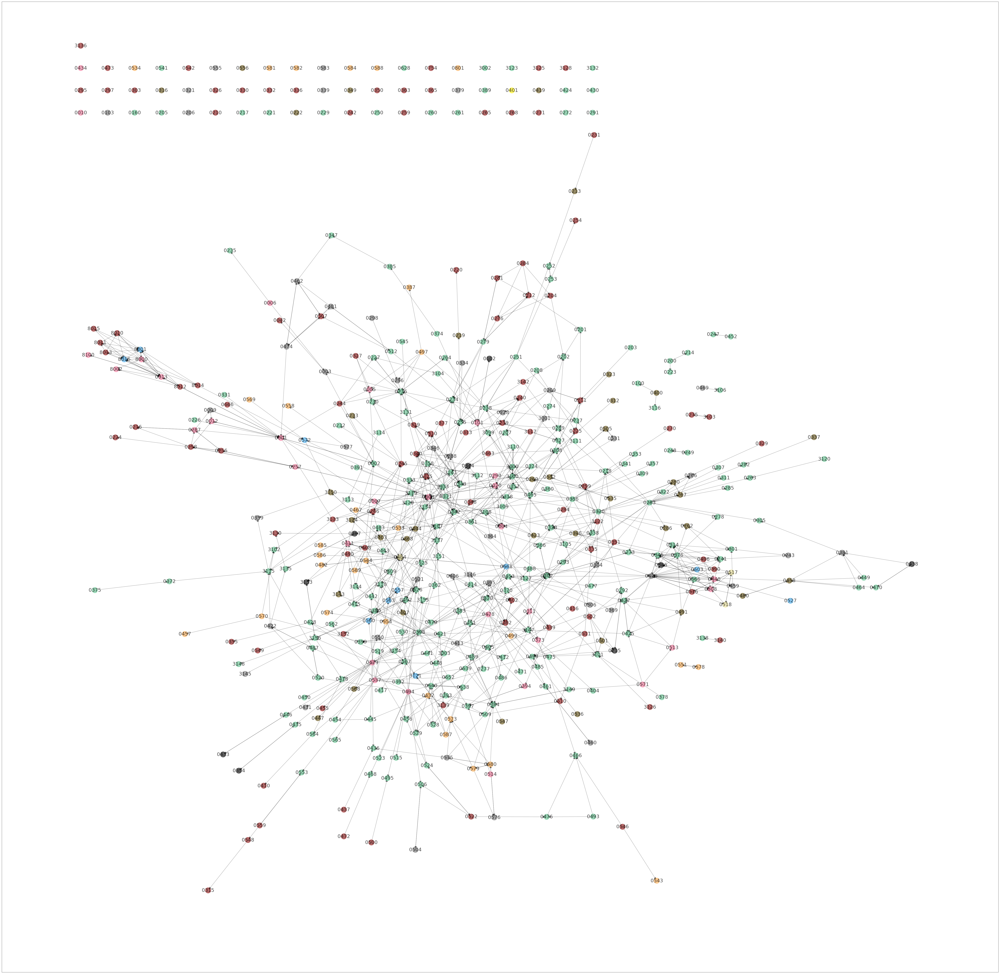

In [11]:
figure_size = (110, 110)
plt.figure(figsize=figure_size)

# position_dict is reused
# Draw
nx.draw_networkx_nodes(pep_graph,
                       pos=new_position_dict,
                       alpha=0.6,
                       node_color=node_color_list,  # !!! Change !!!
                       node_size=1200)
nx.draw_networkx_labels(pep_graph, pos=new_position_dict, font_size=30, alpha=0.7)
nx.draw_networkx_edges(pep_graph, pos=new_position_dict, alpha=0.6, arrowsize=30)

plt.savefig('../images/drawing/colored_network.png')
plt.show()

# Change Node Size by Degree

Now let's resize the node by degree.   
The degree is the number of edges connected to the node.   

<img src="../images/degree.png">

In this case,
- in-degree: The number of other PEPs that are referencing the PEP (referrer)
- out-degree: The number of other PEPs that the PEP is referencing (referent)

## In Degree and Out Degree

NetworkX provides functions to easily calculate the in-degree, out-degree, and degree.

** networkx.DiGraph.in_degree **   
https://networkx.github.io/documentation/stable/reference/classes/generated/networkx.DiGraph.in_degree.html

** networkx.DiGraph.out_degree **   
https://networkx.github.io/documentation/stable/reference/classes/generated/networkx.DiGraph.out_degree.html

** networkx.DiGraph.degree **   
https://networkx.github.io/documentation/stable/reference/classes/generated/networkx.DiGraph.degree.html

In [12]:
# Increase node area in proportion to degree.
# However, this method does not display nodes of degree 0.
# Therefore, min_value specifies the minimum size.
def calc_node_size(value, baseline, min_value):
        if value == 0:
            return baseline * min_value
        else:
            return baseline * value

In [13]:
min_value, baseline_size = 0.1, 1500
in_degree_node_size_list = [calc_node_size(pep_graph.in_degree(node_id), baseline_size, min_value)
                            for node_id in pep_graph.nodes]
out_degree_node_size_list = [calc_node_size(pep_graph.out_degree(node_id), baseline_size, min_value)
                             for node_id in pep_graph.nodes]
degree_node_size_list = [calc_node_size(pep_graph.degree(node_id), baseline_size, min_value)
                         for node_id in pep_graph.nodes]

## In Degree
To measure the importance of individual nodes in an entire network, in-degree is an intuitive indicator.

for example:
- a paper cited from many papers
- a SNS account with many followers
- a module called from many other modules (If there is a problem with this module, there will be a big problem!)

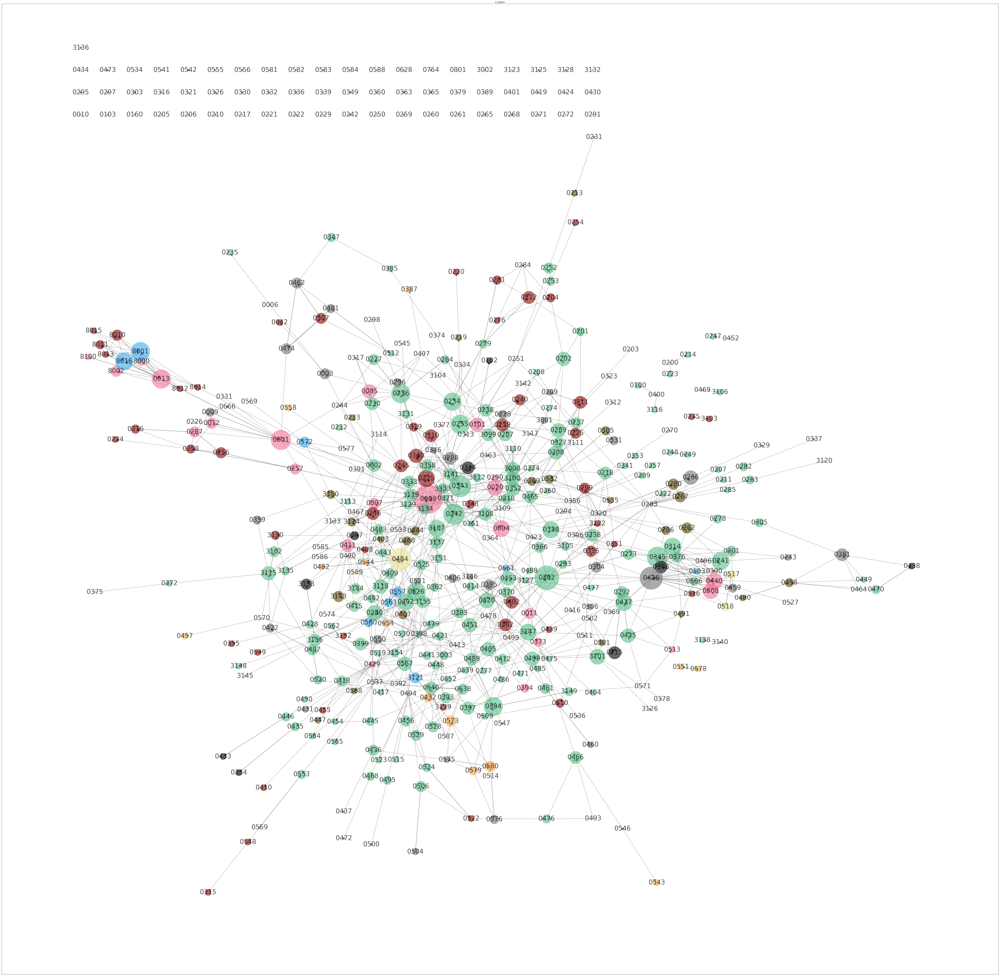

In [14]:
figure_size = (110, 110)
plt.figure(figsize=figure_size)

# position_dict is reused
# Draw
nx.draw_networkx_nodes(pep_graph,
                       pos=new_position_dict,
                       alpha=0.6,
                       node_color=node_color_list,
                       node_size=in_degree_node_size_list)  # !!! Change !!!
nx.draw_networkx_labels(pep_graph, pos=new_position_dict, font_size=40, alpha=0.7)
nx.draw_networkx_edges(pep_graph, pos=new_position_dict, alpha=0.6, arrowsize=30)

plt.title('in_degree')
plt.savefig('../images/drawing/colored_network_in_degree.png')
plt.show()

The diagram has become sharper. There are some interesting nodes.   

For example:   
- What is the big red node in the center of the diagram?
- What is the large gray node at the end of the diagram? (Gray means "Deferred")

### Top 10 (in-degree)

Alternatively, you can check the ranking of in-degree.   

In [15]:
# Preprocess
header_df = pd.DataFrame(dict(pep_graph.nodes(data=True))).T
header_df = header_df.reset_index().rename(columns={'index': 'pep_id'})

target_columns = ['pep_id', 'Title', 'Type', 'Status', 'Created_dt']
degree_df = header_df.copy()
degree_df = degree_df[target_columns]
degree_df['in_degree'] = degree_df['pep_id'].apply(lambda x: pep_graph.in_degree(x))
degree_df['out_degree'] = degree_df['pep_id'].apply(lambda x: pep_graph.out_degree(x))
degree_df['degree'] = degree_df['pep_id'].apply(lambda x: pep_graph.degree(x))
degree_df = degree_df.set_index('pep_id')

In [16]:
def highlight_status(s):
    return ['background-color: {}'.format(STATUS_COLOR_MAP_DICT[v]) for v in s]


degree_df.sort_values('in_degree', ascending=False)[:10].style.bar(['in_degree'], color='#40AAEF').apply(highlight_status, subset=['Status'])

,Title,Type,Status,Created_dt,in_degree,out_degree,degree
pep_id,,,,,,,
0008,Style Guide for Python Code,Process,Active,2001-07-05 00:00:00,21,8,29
0302,New Import Hooks,Standards Track,Final,2002-12-19 00:00:00,15,3,18
0426,Metadata for Python Software Packages 2.0,Informational,Withdrawn,2012-08-30 00:00:00,13,14,27
0484,Type Hints,Standards Track,Provisional,2014-09-29 00:00:00,13,11,24
0343,"The ""with"" Statement",Standards Track,Final,2005-05-13 00:00:00,12,5,17
0342,Coroutines via Enhanced Generators,Standards Track,Final,2005-05-10 00:00:00,11,4,15
0345,Metadata for Python Software Packages 1.2,Standards Track,Final,2005-04-28 00:00:00,11,4,15
0001,PEP Purpose and Guidelines,Process,Active,2000-06-13 00:00:00,10,7,17
0013,Python Language Governance,Informational,Active,2018-12-16 00:00:00,9,5,14


### Degree distribution
Let's draw the degree distribution.   
You can see that many PEPs have an in-order of 3 or less, and some PEPs are referenced a lot.

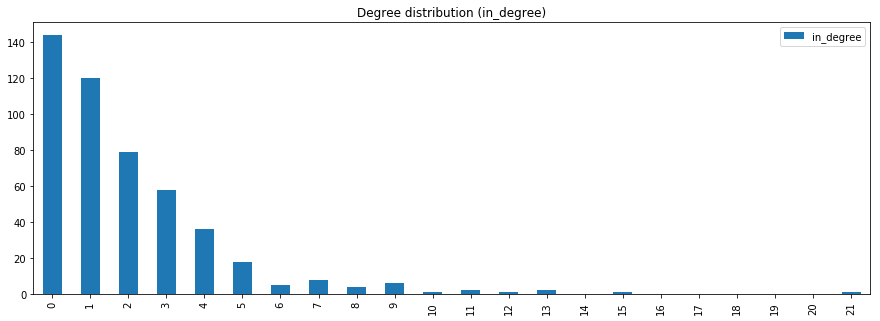

In [17]:
target = 'in_degree'
work_df = pd.DataFrame(degree_df.groupby(target).size()).rename(columns={0: target})
work_df = pd.concat([pd.DataFrame(index=range(min(work_df.index), max(work_df.index))), work_df], axis=1)
work_df = pd.DataFrame(work_df[target].fillna(0).astype(int))

work_df.plot.bar(figsize=(15, 5), title='Degree distribution ({})'.format(target))

In [18]:
np.percentile(degree_df.in_degree.values, 75)

3.0

## Out Degree
What does a node with a high out-degree mean?

- A Document that refers to many other documents
- A Module that referes to many other modules

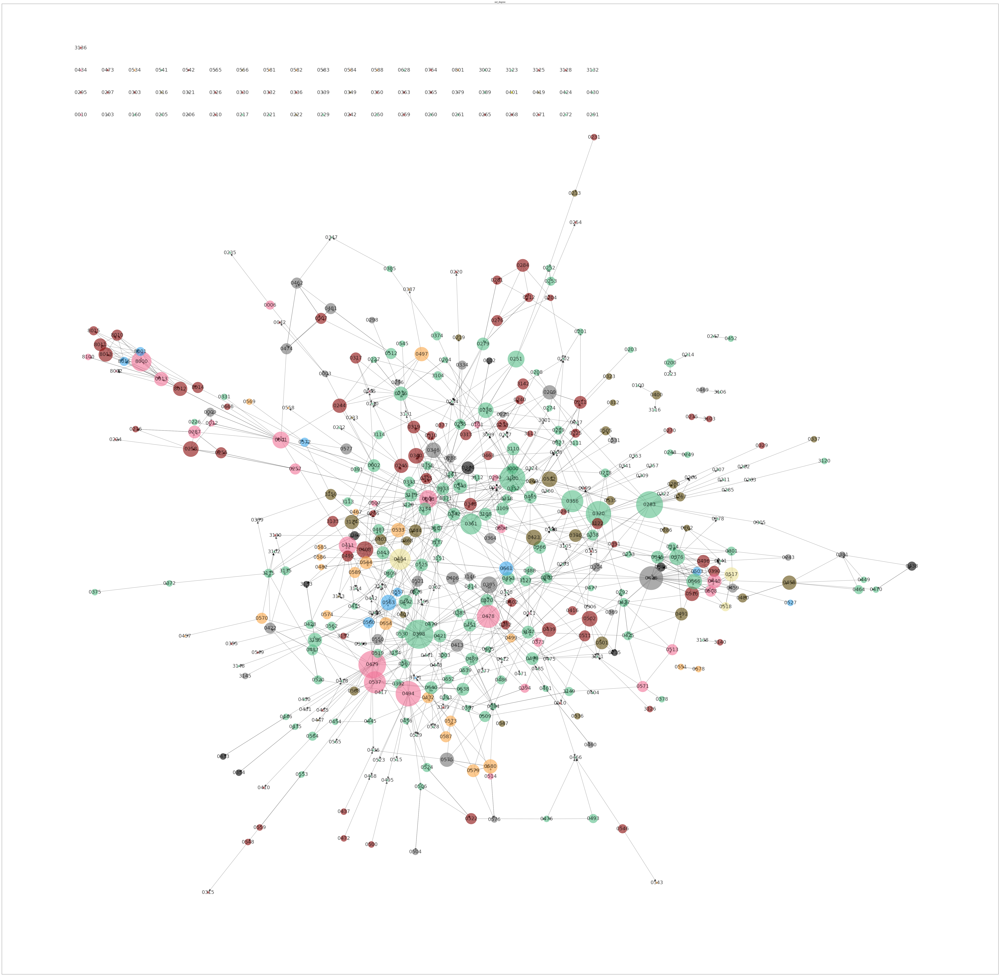

In [19]:
figure_size = (110, 110)
plt.figure(figsize=figure_size)

# position_dict is reused
# Draw
nx.draw_networkx_nodes(pep_graph,
                       pos=new_position_dict,
                       alpha=0.6,
                       node_color=node_color_list,
                       node_size=out_degree_node_size_list)  # !!! Change !!!
nx.draw_networkx_labels(pep_graph, pos=new_position_dict, font_size=30, alpha=0.7)
nx.draw_networkx_edges(pep_graph, pos=new_position_dict, alpha=0.6, arrowsize=30)

plt.title('out_degree')
plt.savefig('../images/drawing/colored_network_out_degree.png')
plt.show()

You may see a different world than when you used in-degree.
<img src="../images/in-degree_out-degree.png">

### Top10 (out-degree)
Let's look at the ranking.   
Many of the PEPs in the Top 10 list are "Release Schedule".

In [20]:
degree_df.sort_values('out_degree', ascending=False).head(10).style.bar(['out_degree'], color='#40AAEF').apply(highlight_status, subset=['Status'])

,Title,Type,Status,Created_dt,in_degree,out_degree,degree
pep_id,,,,,,,
0398,Python 3.3 Release Schedule,Informational,Final,2011-03-23 00:00:00,1,21,22
0429,Python 3.4 Release Schedule,Informational,Active,2012-10-17 00:00:00,1,19,20
0283,Python 2.3 Release Schedule,Informational,Final,2002-02-27 00:00:00,0,18,18
3100,Miscellaneous Python 3.0 Plans,Process,Final,2004-08-20 00:00:00,5,17,22
0494,Python 3.6 Release Schedule,Informational,Active,2015-05-30 00:00:00,0,16,16
0320,Python 2.4 Release Schedule,Informational,Final,2003-07-29 00:00:00,0,16,16
0426,Metadata for Python Software Packages 2.0,Informational,Withdrawn,2012-08-30 00:00:00,13,14,27
0478,Python 3.5 Release Schedule,Informational,Active,2014-09-22 00:00:00,0,13,13
0356,Python 2.5 Release Schedule,Informational,Final,2006-02-07 00:00:00,0,12,12


#### Release Schedule
When a new feature is added to Python, the PEP is linked from the next Python release schedule PEP.   
The release schedule PEP naturally has links to many PEPs.   
Take **PEP 398** as an example.   

**PEP 398 -- Python 3.3 Release Schedule**   
https://www.python.org/dev/peps/pep-0398/

<img src="../images/sample_release_schedule.png">

**PEP 3100** does not include "Release Schedule" in its title, but it has a list of features that will be added or changed in Python 3.0. It is similar to Release Schedule in that it has a list of changes in a version.

**PEP 3100 -- Miscellaneous Python 3.0 Plans**   
https://www.python.org/dev/peps/pep-3100/

#### PEP 426 (Gray and Large Node)
Another focus is PEP 426. This PEP was also ranked in the top 10 in the in-degree ranking.

**PEP 426 -- Metadata for Python Software Packages 2.0**   
https://www.python.org/dev/peps/pep-0426/

### Top 10 (out_degree) without Release Schedule PEP

If PEPs with "Release Schedule" in their "Title" are excluded, what happens to the ranking results?

In [21]:
degree_df['is_release_schedule'] = degree_df.Title.apply(lambda x: 'Release Schedule' in x)
without_release_schedule_df = degree_df[~ degree_df.is_release_schedule]
del without_release_schedule_df['is_release_schedule']
del degree_df['is_release_schedule']
without_release_schedule_df.sort_values(by='out_degree', ascending=False).head(10).style.bar(['out_degree'], color='#40AAEF').apply(highlight_status, subset=['Status'])

,Title,Type,Status,Created_dt,in_degree,out_degree,degree
pep_id,,,,,,,
3100,Miscellaneous Python 3.0 Plans,Process,Final,2004-08-20 00:00:00,5,17,22
0426,Metadata for Python Software Packages 2.0,Informational,Withdrawn,2012-08-30 00:00:00,13,14,27
0484,Type Hints,Standards Track,Provisional,2014-09-29 00:00:00,13,11,24
8000,Python Language Governance Proposal Overview,Informational,Active,2018-08-24 00:00:00,2,10,12
0008,Style Guide for Python Code,Process,Active,2001-07-05 00:00:00,21,8,29
0411,Provisional packages in the Python standard library,Informational,Active,2012-02-10 00:00:00,4,8,12
0001,PEP Purpose and Guidelines,Process,Active,2000-06-13 00:00:00,10,7,17
0408,Standard library __preview__ package,Standards Track,Rejected,2012-01-07 00:00:00,1,7,8
0395,Qualified Names for Modules,Standards Track,Withdrawn,2011-03-04 00:00:00,3,7,10


### Degree Distribution

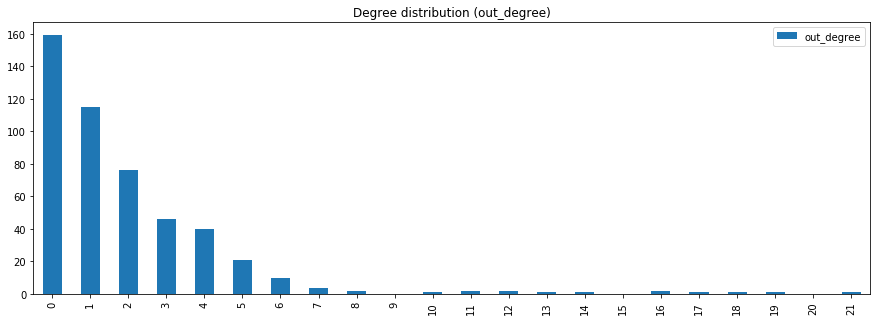

In [22]:
target = 'out_degree'
work_df = pd.DataFrame(degree_df.groupby(target).size()).rename(columns={0: target})
work_df = pd.concat([pd.DataFrame(index=range(min(work_df.index), max(work_df.index))), work_df], axis=1)
work_df = pd.DataFrame(work_df[target].fillna(0).astype(int))

work_df.plot.bar(figsize=(15, 5), title='Degree distribution ({})'.format(target))

In [23]:
np.percentile(degree_df.out_degree.values, 75)

3.0

## Degree
Finally, let's look at the result of degree (sum of in-degree and out-degree).

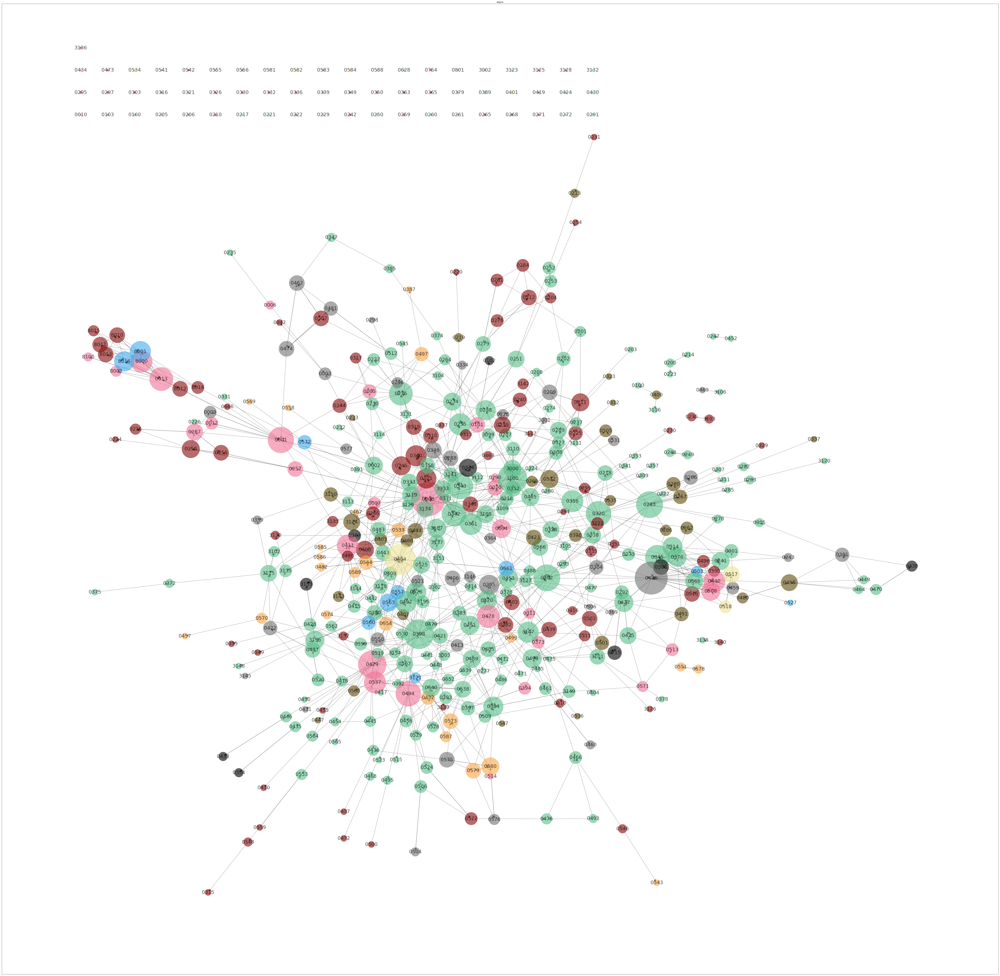

In [24]:
figure_size = (110, 110)
plt.figure(figsize=figure_size)

# position_dict is reused
# Draw
nx.draw_networkx_nodes(pep_graph,
                       pos=new_position_dict,
                       alpha=0.6,
                       node_color=node_color_list,
                       node_size=degree_node_size_list)  # !!! Change !!!
nx.draw_networkx_labels(pep_graph, pos=new_position_dict, font_size=30, alpha=0.7)
nx.draw_networkx_edges(pep_graph, pos=new_position_dict, alpha=0.6, arrowsize=30)

plt.title('degree')
plt.savefig('../images/drawing/colored_network_degree.png')
plt.show()

### Top 10 (degree)

In [25]:
degree_df.sort_values('degree', ascending=False).head(10).style.bar(['degree'], color='#40AAEF').apply(highlight_status, subset=['Status']).bar(['in_degree', 'out_degree'], color='#a8dcff')

,Title,Type,Status,Created_dt,in_degree,out_degree,degree
pep_id,,,,,,,
0008,Style Guide for Python Code,Process,Active,2001-07-05 00:00:00,21,8,29
0426,Metadata for Python Software Packages 2.0,Informational,Withdrawn,2012-08-30 00:00:00,13,14,27
0484,Type Hints,Standards Track,Provisional,2014-09-29 00:00:00,13,11,24
0398,Python 3.3 Release Schedule,Informational,Final,2011-03-23 00:00:00,1,21,22
3100,Miscellaneous Python 3.0 Plans,Process,Final,2004-08-20 00:00:00,5,17,22
0429,Python 3.4 Release Schedule,Informational,Active,2012-10-17 00:00:00,1,19,20
0302,New Import Hooks,Standards Track,Final,2002-12-19 00:00:00,15,3,18
0283,Python 2.3 Release Schedule,Informational,Final,2002-02-27 00:00:00,0,18,18
0001,PEP Purpose and Guidelines,Process,Active,2000-06-13 00:00:00,10,7,17


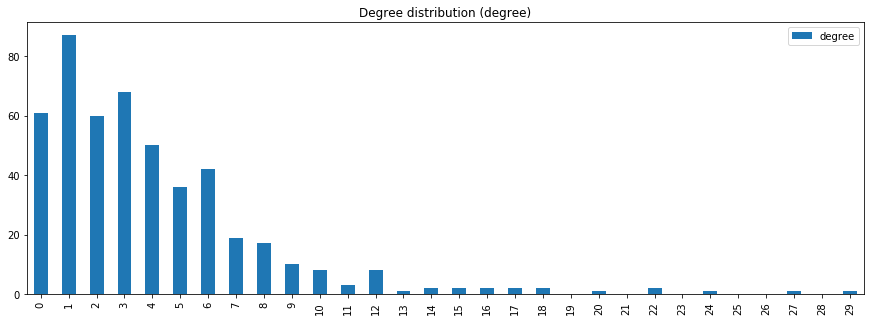

In [26]:
target = 'degree'
work_df = pd.DataFrame(degree_df.groupby(target).size()).rename(columns={0: target})
work_df = pd.concat([pd.DataFrame(index=range(min(work_df.index), max(work_df.index))), work_df], axis=1)
work_df = pd.DataFrame(work_df[target].fillna(0).astype(int))

work_df.plot.bar(figsize=(15, 5), title='Degree distribution ({})'.format(target))

In [27]:
np.percentile(degree_df.degree.values, 75)

6.0

## Other Centralities
There are many other metrics that can be used to measure the importance of a node.   
The value indicating which node in the network is the center is called the **"centrality"**.   

NetworkX provides functions to measure various centralities.   
As an alternative to simple in-degree and out-degree, you can also reflect other centralities in the node size.   

**Centrality**   
https://networkx.github.io/documentation/stable/reference/algorithms/centrality.html

# Interactive Visualization
Just a still image may not be enough to get the details.   
The following URL provides an interactive visualization of the PEP network.   
https://komo-fr.github.io/pep_map_site/network.html

On the previous page, you can:.
- Tap or hover a node to see more information
- Zoom Network
- Change Node Size
- Search for a specific PEP from the top left box

## Tap or Hover a Node to See More Information
<img src="../images/interactive/demo_tap_and_hover.gif">


## Zoom Network
<img src="../images/interactive/demo_zoom.gif">

## Change Node Size
<img src="../images/interactive/demo_change_node_size.gif">

## Search for a Specific PEP from the Top Left Box
<img src="../images/interactive/demo_search.gif">

# Notes on Drawing with NetworkX

NetworkX has simple rendering features, but they are minimal, as the official documentation says.   

> NetworkX provides basic functionality for visualizing graphs, but its main goal is to enable graph analysis rather than perform graph visualization. In the future, graph visualization functionality may be removed from NetworkX or only available as an add-on package.NetworkX provides basic functionality for visualizing graphs, but its main goal is to enable graph analysis rather than perform graph visualization. In the future, graph visualization functionality may be removed from NetworkX or only available as an add-on package.

If you want a richer drawing, other tools are recommended. For more information, see the following URL:

**Drawing**   
https://networkx.github.io/documentation/stable/reference/drawing.html

# Save Graph

In [28]:
# Set position as node attributes
position_x = {node_id: position[0] for node_id, position in new_position_dict.items()}
position_y = {node_id: position[1] for node_id, position in new_position_dict.items()}

nx.set_node_attributes(pep_graph, new_position_dict, 'position')
nx.set_node_attributes(pep_graph, position_x, 'position_x')
nx.set_node_attributes(pep_graph, position_y, 'position_y')

In [29]:
# Save
nx.write_gpickle(pep_graph, '../data/pep_graph_with_position.gpickle')

# Next Notebook
This notebook showed you how to use NetworkX to draw a big picture of your network. We also introduced metrics that measure the importance of a node, such as `in-degree`, `out-degree`, and `degree`.

The next notebook ([03-community_detection.ipynb](https://github.com/komo-fr/SciPyJapan_2019_talk/blob/master/notebooks/03-community_detection.ipynb)) will show you the results of breaking 486 PEPs into smaller groups.